<h1>COMP28512: Mobile Systems 2019-20</h1>
<h2>Oliver O'Hara</h2>
<h2>Task 2</h2>


<h4>Experiment 2.1 Fourier series</h4>

Plot 500 samples of the periodic wave wave form which has the Fourier Series F = 128 Hz...

In [2]:
# Imports
import numpy as np
from matplotlib import pyplot as plt
from scipy import fftpack
from scipy.io import wavfile
from IPython import display as Dp
#S = fftpack.dct(s, norm="ortho")
#s = fftpack.idct(S, norm="ortho")

Functions for finding the Fourier series of the 500 sample array...

In [3]:
# 500 samples starting at 0 to 0.0625
timeArray = np.arange(0,0.0625,1/8000)

# Function to construct the Fourier series for part (a)
def findFourier(timeArray):
    timeArray = np.copy(timeArray)
    for i in range(0, 500):
        # The current element in the time array is used as t
        t = timeArray[i]
        timeArray[i] = 0
        # Loop over every odd number (multiplied by 1/k)
        for k in range(1, 250, 2):
            timeArray[i] += (1/k) * np.sin(2 * np.pi * k * 128 * t)
    return(timeArray)

# Function to construct the Fourier series for part (b)
def findFourier3(timeArray):
    timeArray = np.copy(timeArray)
    for i in range(0, 500):
        # The current element in the time array is used as t
        t = timeArray[i]
        timeArray[i] = 0
        # Loop over every odd number (multiplied by 1/k)
        for k in range(1, 250, 2):
            if k == 3:
                timeArray[i] += (1/k) * np.sin(2 * np.pi * k * 128 * t + (np.pi/2))
            else:
                timeArray[i] += (1/k) * np.sin(2 * np.pi * k * 128 * t)
    return(timeArray)

Part (A)...

Part (a)...


Text(0, 0.5, 'Modulus of FFT coefficients')

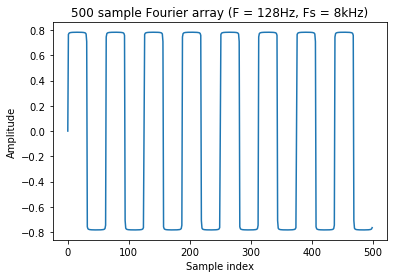

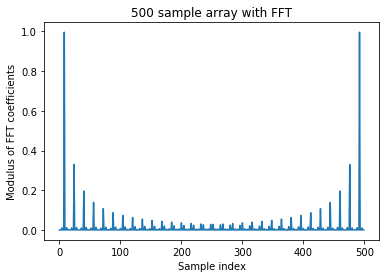

In [4]:
# Part (A)
# Find the fourier series for the time array
fourierArray = findFourier(timeArray)

# Apply the array to an FFT 
fourierFFTArray = fftpack.fft(fourierArray)
fourierFFTArray = abs(fourierFFTArray)
fourierFFTArray /= 250

print("Part (a)...")
# Plot the graphs for the initial array and the FFT
fig, ax1 = plt.subplots(1) 
ax1.plot(np.arange(0, 500), fourierArray)
ax1.set_title("500 sample Fourier array (F = 128Hz, Fs = 8kHz)")
ax1.set_xlabel("Sample index")
ax1.set_ylabel("Amplitude")

fig, ax0 = plt.subplots(1) 
ax0.plot(np.arange(0, 500), fourierFFTArray)
ax0.set_title("500 sample array with FFT")
ax0.set_xlabel("Sample index")
ax0.set_ylabel("Modulus of FFT coefficients")

Part (B)...

Part (b)...


Text(0, 0.5, 'Modulus of FFT coefficients')

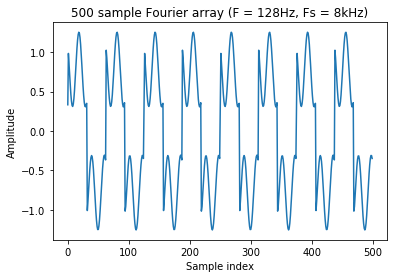

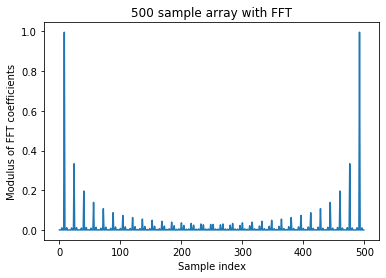

In [5]:
# Part (B)
# Find the fourier series for the time array
fourierArray = findFourier3(timeArray)

# Apply the array to an FFT 
fourierFFTArray = fftpack.fft(fourierArray)
fourierFFTArray = abs(fourierFFTArray)
fourierFFTArray /= 250

print("Part (b)...")
# Plot the graphs for the initial array and the FFT
fig, ax1 = plt.subplots(1) 
ax1.plot(np.arange(0, 500), fourierArray)
ax1.set_title("500 sample Fourier array (F = 128Hz, Fs = 8kHz)")
ax1.set_xlabel("Sample index")
ax1.set_ylabel("Amplitude")

fig, ax0 = plt.subplots(1) 
ax0.plot(np.arange(0, 500), fourierFFTArray)
ax0.set_title("500 sample array with FFT")
ax0.set_xlabel("Sample index")
ax0.set_ylabel("Modulus of FFT coefficients")

<h5>Questions...</h5>

1. Comment on the waveformobtained for Fourier series (a) with about 4 or more non-zero harmonics. What  would  you  expect  the  waveform  to  look  like  if  you  could  take  a  very large number of harmonics?

As you increase the number of harmonics the produce graph begins to resemble the initial waveform more closely

2. What features do you see in the FFT magnitude spectral graph for Fourier series (a)?

We saw high modulus FFT coefficients for the start and end indexes (may be the silence at the start/end)

3. How may the graph be improved?

The graph is symmetrical and so only the first half of the samples need to be plotted. 

4. In what ways are waveforms (a) and (b) similar and different?

Both waveforms alternate between positive and negative amplitudes in a reasonably uniform manner. The difference being the waveform isn't perfectly formed in part (b).

5. Why might waveforms (a) and (b) sound similar over an analog telephone line?

The waveforms will be sampled over a telephone line and the sampled versions of them will be largely the same when reconstructed despite the original waveforms being noticeably different. 

6. The waveform in (a) may be considered to be a binary transmission (1 0 1 0 1 0 ...) that might be sent over an analog telephone line. If this transmission were affectedby phase distortion and produced waveform (b) at the receiver, why might this cause a problem?



<h4>Experiment 2.2 Frequency-domain processing by FFT</h4>

Use frequency domain processing in an attempt to remove noise from a noisy wav file...

Sound bar for unmodified noisySignal file...


Sampling frequency (8000Hz)


/opt/anaconda3/lib/python3.7/site-packages/numpy/core/_asarray.py:85: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


Text(0, 0.5, 'Magnitude')

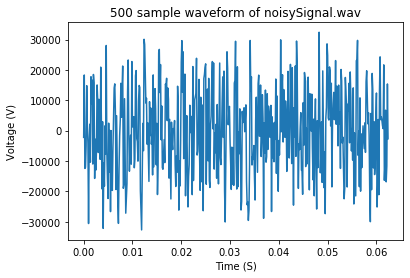

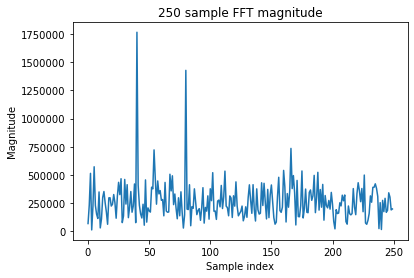

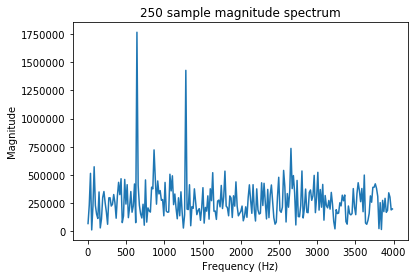

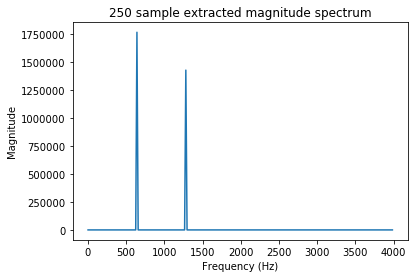

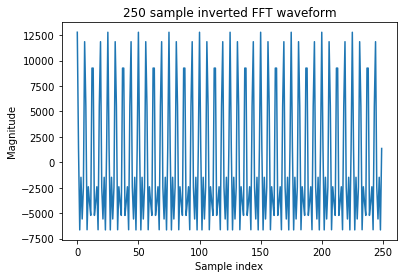

In [6]:
# Read in noisySignal.wav and display it along with its sampling frequency
(Fs, noisySignal) = wavfile.read("noisySignal.wav")
print("Sound bar for unmodified noisySignal file...")
Dp.display(Dp.Audio(noisySignal, rate=Fs))
print("Sampling frequency (" + str(Fs) + "Hz)")

# Extract 500 samples and plot the waveform (48)
samples = noisySignal[0::48]

fig, ax0 = plt.subplots(1) 
ax0.plot((np.arange(0, 500) * (1/Fs)), samples)
ax0.set_title("500 sample waveform of noisySignal.wav")
ax0.set_xlabel("Time (S)")
ax0.set_ylabel("Voltage (V)")

# Apply an FFT to obtain a complex array
samplesFFTArray = fftpack.fft(samples)

# Find the magnitude and phase form
magnitudeArray = np.arange(0, 500)
phaseArray = np.arange(0, 500)
for k in range(0, 500):
    magnitudeArray[k] = np.sqrt((samplesFFTArray[k].real ** 2) + (samplesFFTArray[k].imag ** 2))
    phaseArray[k] = np.arctan2(samplesFFTArray[k].imag, samplesFFTArray[k].real)
    
# Plots for magnitude
magnitudeDisplayArray = np.split(magnitudeArray, 2)
magnitudeDisplayArray = magnitudeDisplayArray[0]
fig, ax1 = plt.subplots(1) 
ax1.plot(np.arange(0, 250), magnitudeDisplayArray)
ax1.set_title("250 sample FFT magnitude")
ax1.set_xlabel("Sample index")
ax1.set_ylabel("Magnitude")

# Find and dislpay the magnitude spectrum
frequencyArray = np.arange(0, 250)
for i in range(0, 250):
    frequencyArray[i] = (i * (Fs/500))

fig, ax2 = plt.subplots(1) 
ax2.plot(frequencyArray, magnitudeDisplayArray)
ax2.set_title("250 sample magnitude spectrum")
ax2.set_xlabel("Frequency (Hz)")
ax2.set_ylabel("Magnitude")

# Eliminate noise and extract the periodic components
extractedMagnitudeArray = np.arange(0, 250)
for i in range(0, 250):
    if (magnitudeDisplayArray[i] < 1000000):
        extractedMagnitudeArray[i] = 0
        
    else:
        extractedMagnitudeArray[i] = magnitudeDisplayArray[i]
        
fig, ax3 = plt.subplots(1) 
ax3.plot(frequencyArray, extractedMagnitudeArray)
ax3.set_title("250 sample extracted magnitude spectrum")
ax3.set_xlabel("Frequency (Hz)")
ax3.set_ylabel("Magnitude")

# Apply inverse FFT and produce the waveform
inverseFFTMagnitudeArray = fftpack.ifft(extractedMagnitudeArray)

fig, ax4 = plt.subplots(1) 
ax4.plot(np.arange(0, 250), inverseFFTMagnitudeArray)
ax4.set_title("250 sample inverted FFT waveform")
ax4.set_xlabel("Sample index")
ax4.set_ylabel("Magnitude")

<h5>Questions...</h5>

1. Why do we only need to plot the first N/2 samples of the magnitude spectrum?

The amplitude spectrum is symmetrical and so only the first half of the samples need to be plotted.

2. How is the periodic part of the sound and the noise seen in the magnitude spectrum?

The periodic part of the sound is represented in the peaks in magnitude on the magnitude spectrum. 

3. What  value  of  threshold  was  chosen  and  why?    What  would  happen  if  it  were  (a)  too high or (b) too low?

I decided to use a threshold of 1000000 based on the previously plotted graphs. If I had used a threshold that was too low then it would include alot of the noise that came with the lower amplitude sounds. If I had picked a threshold that was too high then the periodic part of the sound would also be removed. 

4. Has any of the noise been removed by this ‘spectral subtraction’ process?

A large proportion of the noise was removed by this process, making the overall quality of the sound better. 

5. What Fourier series components are present in the periodic part of the sound?  What are their frequencies and relative amplitudes?

The periodic part of the sound represent the given harmonics of the fourier series that are most prominent. The frequencies and amplitudes can then be read off the magnitude spectrum by looking at the peaks.

6. Did  you  have  any  chance  of  answering  question  5  by  just  observing  the  time-domain waveform (i.e. if you had never heard of the FFT)?

Without a knowledge of FFT you may not know what these peaks represent but you would still be able to identify the frequencies and magnitudes associated with them.

<h4>Experiment 2.3 Transforming music files to and from frequency-domain</h4>

Testing the effect of DCT on a cosine wave...

Text(0.5, 1.0, 'Inverse DCT sampled cosine wave')

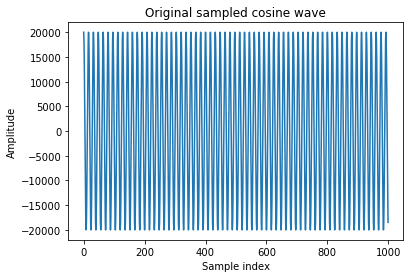

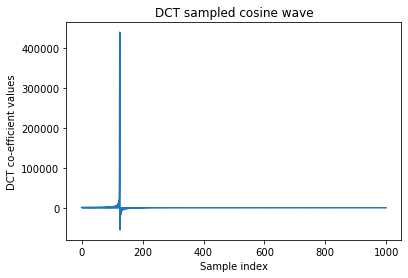

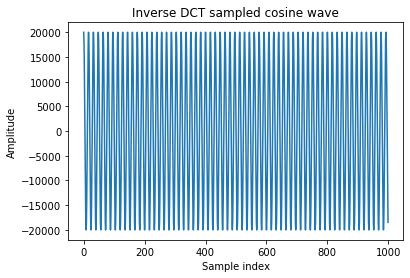

In [7]:
# Generating and sampling a 500Hz cosine-wave 
def genCos(A, f, Fs, D):
    # function to generate pure sine-wave of duration D seconds
    NS = int(D * Fs)             # Number of samples required
    n = np.arange(0, NS)    # Makes n an array of integers 0, 1, 2, ... NS-1
    y = A * np.cos( 2 * (np.pi) * f * n * T)
    y = np.int16(y)   # Convert to int16
    return y

# Use the function to generate cosine wave
Fs = 8000                   # Sampling frequency (Hz)
T = 1.0  / Fs               # Sampling period (seconds)
A = 20000.0                 # Amplitude of cosine wave
D = 16                      # Duration cosine wave (Hz)
f = 500                     # Frequency of the cosine wave

# Generate the cosine wave and extract a 1000 sample segment
cosineWave = genCos(A, f, Fs, D)
cosineSamples = cosineWave[:1000]

# Graph for the cosine wave (using only the first 200 samples)
fig, ax0 = plt.subplots(1)
ax0.plot(cosineSamples)
ax0.set_xlabel("Sample index")
ax0.set_ylabel("Amplitude")
ax0.set_title("Original sampled cosine wave")

# Apply DCT to the sampled cosine wave and display the graph
cosineSamplesDCT = fftpack.dct(cosineSamples, norm='ortho')

fig, ax1 = plt.subplots(1)
ax1.plot(cosineSamplesDCT)
ax1.set_xlabel("Sample index")
ax1.set_ylabel("DCT co-efficient values")
ax1.set_title("DCT sampled cosine wave")

# Apply inverse DCT to the sampled cosine wave and display the graph
reverseCosineSamplesDCT = fftpack.idct(cosineSamplesDCT, norm='ortho')

fig, ax2 = plt.subplots(1)
ax2.plot(reverseCosineSamplesDCT)
ax2.set_xlabel("Sample index")
ax2.set_ylabel("Amplitude")
ax2.set_title("Inverse DCT sampled cosine wave")


Testing the effect of DCT on a sine wave...

Text(0.5, 1.0, 'Inverse DCT sampled sine wave')

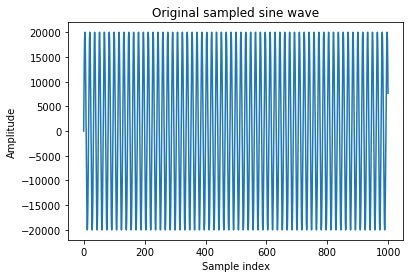

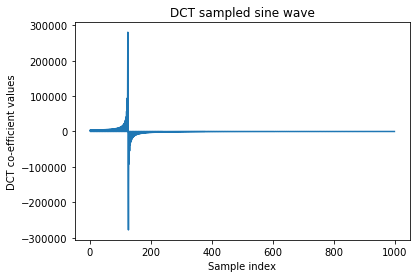

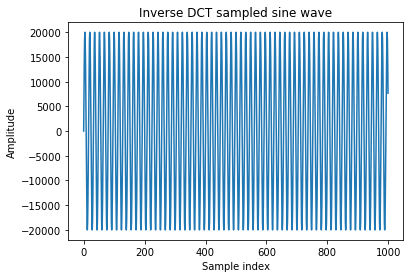

In [8]:
# Generating and sampling a 500Hz sine-wave 
def genSin(A, f, Fs, D):
    # function to generate pure sine-wave of duration D seconds
    NS = int(D * Fs)             # Number of samples required
    n = np.arange(0, NS)    # Makes n an array of integers 0, 1, 2, ... NS-1
    y = A * np.sin( 2 * (np.pi) * f * n * T)
    y = np.int16(y)   # Convert to int16
    return y

# Use the function to generate sine wave
Fs = 8000                   # Sampling frequency (Hz)
T = 1.0  / Fs               # Sampling period (seconds)
A = 20000.0                 # Amplitude of sine wave
D = 16                      # Duration sine wave (Hz)
f = 500                     # Frequency of the sine wave

# Generate the sine wave and extract a 1000 sample segment
sineWave = genSin(A, f, Fs, D)
sineSamples = sineWave[:1000]

# Graph for the sine wave (using only the first 200 samples)
fig, ax0 = plt.subplots(1)
ax0.plot(sineSamples)
ax0.set_xlabel("Sample index")
ax0.set_ylabel("Amplitude")
ax0.set_title("Original sampled sine wave")

# Apply DCT to the sampled sine wave and display the graph
sineSamplesDCT = fftpack.dct(sineSamples, norm='ortho')

fig, ax1 = plt.subplots(1)
ax1.plot(sineSamplesDCT)
ax1.set_xlabel("Sample index")
ax1.set_ylabel("DCT co-efficient values")
ax1.set_title("DCT sampled sine wave")

# Apply inverse DCT to the sampled sine wave and display the graph
reverseSineSamplesDCT = fftpack.idct(sineSamplesDCT, norm='ortho')

fig, ax2 = plt.subplots(1)
ax2.plot(reverseSineSamplesDCT)
ax2.set_xlabel("Sample index")
ax2.set_ylabel("Amplitude")
ax2.set_title("Inverse DCT sampled sine wave")

Testing the effect of DCT on a music file...

In [9]:
# Read in the file
(Fs, HQmusic) = wavfile.read("HQ-music44100-mono.wav")
print("Sound bar for original HQ-Music...")
HQmusic = np.int16(HQmusic)
Dp.display(Dp.Audio(HQmusic,rate=Fs))

# Split the file into segments
splitHQmusic = np.array_split(HQmusic, 862)
splitHQmusic = np.asarray(splitHQmusic)

# Create an array to store the DCT coefficients
DCTcoefficients  = np.array([])
for i in range(0, splitHQmusic.size):
    currentSplitHQmusic = splitHQmusic[i]
    dctF = fftpack.dct(currentSplitHQmusic, norm='ortho')
    DCTcoefficients = np.append(DCTcoefficients, dctF) 
DCTcoefficients = np.int16(DCTcoefficients)

# Convert the coefficients back to the time-domain
splitDCTCoefficients = np.array_split(DCTcoefficients, 862)
splitDCTCoefficients = np.asarray(splitDCTCoefficients)

iDCTcoefficients = np.array([])
for i in range(0, splitDCTCoefficients.size):
    currentSplitDCTCoefficients = splitDCTCoefficients[i]
    idctF = fftpack.idct(currentSplitDCTCoefficients, norm='ortho')
    iDCTcoefficients = np.append(iDCTcoefficients, idctF)
iDCTcoefficients = np.int16(iDCTcoefficients)

# Display the sound bar for the converted music
print("Sound bar for converted HQ-Music...")
Dp.display(Dp.Audio(iDCTcoefficients,rate=Fs))

# Save the processed music to a wav file
wavfile.write("MusicDCT.wav", Fs, iDCTcoefficients)

Sound bar for original HQ-Music...


Sound bar for converted HQ-Music...


Inclusion of frequency-domain processing...

In [10]:
# Read in the file
(Fs, HQmusic) = wavfile.read("HQ-music44100-mono.wav")
print("Sound bar for original HQ-Music...")
HQmusic = np.int16(HQmusic)
Dp.display(Dp.Audio(HQmusic,rate=Fs))

# Split the file into segments
splitHQmusic = np.array_split(HQmusic, 862)
splitHQmusic = np.asarray(splitHQmusic)

# Create an array to store the DCT coefficients
DCTcoefficients  = np.array([])
for i in range(0, splitHQmusic.size):
    currentSplitHQmusic = splitHQmusic[i]
    dctF = fftpack.dct(currentSplitHQmusic, norm='ortho')
    for i in range(0, dctF.size):
        if (i * (Fs/dctF.size) > 16000):
            dctF[i] = 0
    DCTcoefficients = np.append(DCTcoefficients, dctF) 
DCTcoefficients = np.int16(DCTcoefficients)


# Convert the coefficients back to the time-domain
splitDCTCoefficients = np.array_split(DCTcoefficients, 862)
splitDCTCoefficients = np.asarray(splitDCTCoefficients)

iDCTcoefficients = np.array([])
for i in range(0, splitDCTCoefficients.size):
    currentSplitDCTCoefficients = splitDCTCoefficients[i]
    idctF = fftpack.idct(currentSplitDCTCoefficients, norm='ortho')
    iDCTcoefficients = np.append(iDCTcoefficients, idctF)
iDCTcoefficients = np.int16(iDCTcoefficients)

# Display the sound bar for the converted music
print("Sound bar for converted HQ-Music...")
Dp.display(Dp.Audio(iDCTcoefficients,rate=Fs))

# Save the processed music to a wav file
wavfile.write("FrequencyDomainMusicDCT.wav", Fs, iDCTcoefficients)

Sound bar for original HQ-Music...


Sound bar for converted HQ-Music...


<h5>Questions...</h5>

1. Why does music have to be split up into sections when we wish to apply frequency-domain processing?

The frequency can vary massively across a piece of music and so where it may be appropriate to remove certain frequencies in one part of a song, it may not be appropriate in others. Splitting the music into sections allows the frequencies to be analysed and removed on a section by section basis.

2. Does the segmented DCT transformation, saving to an array, reading back and/or reconstruction introduce any noticeable distortion?  Is there any change in loudness?  If there is some distortion, what could be the cause of it?

Segmented DCT transformation appears to introduce some distortion, making the music appear like it is in the distance (giving the effect that its volume has also been effected). The distortion is a result of the higher frequencies being removed, some of which may contribute to some of the notes heard in the music.

3. What did you observe when analyzing the original music file using Audacity?

The original music file in audacity had frequencies reaching up to 19000/20000Hz, higher than the 16000Hz that is limited when using an mp3 file.

4. How did you process the DCT coefficients to remove all frequency components above 16 kHz?   What proportion of DCT coefficients were set to zero?

Applying DCT along with removing frequencies above 16 kHz resulted in just over 82% of the DCT coefficients being set to 0. 

5. Did you notice any change in the sound quality after the frequency-domain processing?

There was noticeable change in sound quality when making these changes, with the higher frequencies being removed.

6. How was the spectrum affected as viewed using Audacity.

The spectrum had been narrowed after applying DCT as the higher frequencies have been removed.

<h4>Experiment 2.4 Principles of DCT transform encoding</h4>

Experimenting with the effect of a psycho-acoustical masking function on a music file...

In [14]:
# Read in the file
(Fs, HQmusic) = wavfile.read("HQ-music44100-mono.wav")
print("Sound bar for original HQ-Music...")
HQmusic = np.int16(HQmusic)
Dp.display(Dp.Audio(HQmusic,rate=Fs))

# Split the file into segments
splitHQmusic = np.array_split(HQmusic, 862)
splitHQmusic = np.asarray(splitHQmusic)

# Create an array to store the DCT coefficients
DCTcoefficients  = np.array([])
for i in range(0, splitHQmusic.size):
    currentSplitHQmusic = splitHQmusic[i]
    dctF = fftpack.dct(currentSplitHQmusic, norm='ortho')
    for i in range(0, dctF.size):
        if (i * (Fs/dctF.size) > 16000):
            dctF[i] = 0
    DCTcoefficients = np.append(DCTcoefficients, dctF) 
DCTcoefficients = np.int16(DCTcoefficients)

# Find the magnitudes for the DCT coefficients
magnitudeArray = np.arange(0, DCTcoefficients.size)
for k in range(0, DCTcoefficients.size):
    magnitudeArray[k] = np.sqrt((DCTcoefficients[k].real ** 2) + (DCTcoefficients[k].imag ** 2))
    # print(magnitudeArray[k]) 
    

    
# Physcho-acuostical masking function (1000)
nonZeroCoefficients = 0
for i in range(0, magnitudeArray.size):
        if (magnitudeArray[i] < 1000):
            DCTcoefficients[i] = 0
        if (DCTcoefficients[i] < 0):
            nonZeroCoefficients += 1
            
# Convert the coefficients back to the time-domain
splitDCTCoefficients = np.array_split(DCTcoefficients, 862)
splitDCTCoefficients = np.asarray(splitDCTCoefficients)

iDCTcoefficients = np.array([])
for i in range(0, splitDCTCoefficients.size):
    currentSplitDCTCoefficients = splitDCTCoefficients[i]
    idctF = fftpack.idct(currentSplitDCTCoefficients, norm='ortho')
    iDCTcoefficients = np.append(iDCTcoefficients, idctF)
iDCTcoefficients = np.int16(iDCTcoefficients)

# Display the sound bar for the converted music
print("Sound bar for converted HQ-Music (1000)...")
print("Numer of non-zero DCT coefficients: " + str((nonZeroCoefficients/DCTcoefficients.size)*100) + "%")
Dp.display(Dp.Audio(iDCTcoefficients,rate=Fs))   
    
    
    
    
# Physcho-acuostical masking function (3000)
nonZeroCoefficients = 0
for i in range(0, magnitudeArray.size):
        if (magnitudeArray[i] < 3000):
            DCTcoefficients[i] = 0
        if (DCTcoefficients[i] < 0):
            nonZeroCoefficients += 1
            
# Convert the coefficients back to the time-domain
splitDCTCoefficients = np.array_split(DCTcoefficients, 862)
splitDCTCoefficients = np.asarray(splitDCTCoefficients)

iDCTcoefficients = np.array([])
for i in range(0, splitDCTCoefficients.size):
    currentSplitDCTCoefficients = splitDCTCoefficients[i]
    idctF = fftpack.idct(currentSplitDCTCoefficients, norm='ortho')
    iDCTcoefficients = np.append(iDCTcoefficients, idctF)
iDCTcoefficients = np.int16(iDCTcoefficients)

# Display the sound bar for the converted music
print("Sound bar for converted HQ-Music (3000)...")
print("Numer of non-zero DCT coefficients: " + str((nonZeroCoefficients/DCTcoefficients.size)*100) + "%")
Dp.display(Dp.Audio(iDCTcoefficients,rate=Fs))





# Physcho-acuostical masking function (5000)
nonZeroCoefficients = 0
for i in range(0, magnitudeArray.size):
        if (magnitudeArray[i] < 5000):
            DCTcoefficients[i] = 0
        if (DCTcoefficients[i] < 0):
            nonZeroCoefficients += 1
            
# Convert the coefficients back to the time-domain
splitDCTCoefficients = np.array_split(DCTcoefficients, 862)
splitDCTCoefficients = np.asarray(splitDCTCoefficients)

iDCTcoefficients = np.array([])
for i in range(0, splitDCTCoefficients.size):
    currentSplitDCTCoefficients = splitDCTCoefficients[i]
    idctF = fftpack.idct(currentSplitDCTCoefficients, norm='ortho')
    iDCTcoefficients = np.append(iDCTcoefficients, idctF)
iDCTcoefficients = np.int16(iDCTcoefficients)

# Display the sound bar for the converted music
print("Sound bar for converted HQ-Music (5000)...")
print("Numer of non-zero DCT coefficients: " + str((nonZeroCoefficients/DCTcoefficients.size)*100) + "%")
Dp.display(Dp.Audio(iDCTcoefficients,rate=Fs))




# Physcho-acuostical masking function (8000)
nonZeroCoefficients = 0
for i in range(0, magnitudeArray.size):
        if (magnitudeArray[i] < 8000):
            DCTcoefficients[i] = 0
        if (DCTcoefficients[i] < 0):
            nonZeroCoefficients += 1
            
# Convert the coefficients back to the time-domain
splitDCTCoefficients = np.array_split(DCTcoefficients, 862)
splitDCTCoefficients = np.asarray(splitDCTCoefficients)

iDCTcoefficients = np.array([])
for i in range(0, splitDCTCoefficients.size):
    currentSplitDCTCoefficients = splitDCTCoefficients[i]
    idctF = fftpack.idct(currentSplitDCTCoefficients, norm='ortho')
    iDCTcoefficients = np.append(iDCTcoefficients, idctF)
iDCTcoefficients = np.int16(iDCTcoefficients)

# Display the sound bar for the converted music
print("Sound bar for converted HQ-Music (8000)...")
print("Numer of non-zero DCT coefficients: " + str((nonZeroCoefficients/DCTcoefficients.size)*100) + "%")
Dp.display(Dp.Audio(iDCTcoefficients,rate=Fs))


Sound bar for original HQ-Music...


Sound bar for converted HQ-Music (1000)...
Numer of non-zero DCT coefficients: 7.65259903333443%


Sound bar for converted HQ-Music (3000)...
Numer of non-zero DCT coefficients: 4.008725613689781%


Sound bar for converted HQ-Music (5000)...
Numer of non-zero DCT coefficients: 2.693534361072153%


Sound bar for converted HQ-Music (8000)...
Numer of non-zero DCT coefficients: 1.725394869166815%


Number of bits required to represent the music with 16 bits per DCT coefficient and no frequency domain processing:     14,112,016 bits

Number of bits required to represent the music with 16 bits per DCT coefficient and frequency domain processing (1000):  1,079,936 bits

Number of bits required to represent the music with 16 bits per DCT coefficient, frequency domain processing (1000) and 6 bits representing non-zero DCT coefficients:  5,966,966 bits

This gives 42.28% of the original bit rate

<h5>Questions...</h5>

1. What is the effect of varying the constant threshold?  What happens with a value that (a) is definitely too high, (b) too low and (c) potentially satisfactory?  Give the values.

(a) Introducing a threshold that is too high (e.g. 8000 shown above) makes the music almost unrecognisable as only the highest magnitude sounds are kept.

(b) Introducing a threshold that is too low doesn't give a noticeable saving in bits and so would be pointless applying, despite this it wouldn't have a particularly noticeable impact on the music

(c) A threshold such as the 1000 one shown above gives a noticeable bit saving whilst still giving satisfactory music, with only small amplitude sounds like deep base sounds being missing

2. Is  there  any  advantage  to  having  a  threshold  that  varies  from  section  to  section according to the loudness?

Applying the threshold section by section would make sense for music pieces that vary greatly in amplitude, allowing more to be removed from areas of high amplitude with less being removed from low amplitude areas where it would be noticeable.

3. For the potentially satisfactory threshold or thresholds, what percentage bit-rate saving is achieved  with  zero  and  16  bits  assumed  to  be  required  for  zero  and  non-zero  DCT coefficients respectively.

For a satisfactory threshold of 1000 I recieved a saving of just under 11% with the original sound file having around 18% non-zero co-efficient rate.

4. What  was  the  minimum  number  of  bits  per  non-zero  DCT  coefficient  that  gave acceptable   sound   quality   with   the   threshold   or   thresholds   found   to   be   potentially satisfactory?

For a satisfactory threshold of 1000 I found that using 6 bits for non-zero DCT values gave a satisfactory sound quality, with anything lower than this introducing too much distortion.

5. What bit-rate saving (in percentage terms) is achieved with the number of bits per non-zero DCT coefficient given in your answer to question 4?

42.28%

6. Did  you  observe  any distortion  due  to  discontinuities at  frame  boundaries? If  so, what causes this distortion and what techniques are available for reducing it?

Distortion can be introduced at frame boundaries where the two frames vary greatly in amplitude as it will cause the introduction/removal of certain magnitude sounds suddenly. This can be reduced by applying the mask based on the current frame as well as the frames following it (temporal masking). 

<h4>Experiment 2.4 Principles of DCT transform encoding</h4>

Functions for run length encoding and decoding...

In [12]:
def runLengthEncoding (frame):
    returnArray = np.array([])
    currentItem = 0
    storedNumbers = 0
    while (currentItem < frame.size):
        currentNumberOfZeros = 0
        # noZeros = True
        while (frame[currentItem] == 0 and currentItem < frame.size - 1):
            currentNumberOfZeros += 1
            currentItem += 1
            # noZeros = False
        print("(" + str(currentNumberOfZeros) + "," + str(frame[currentItem]) + ")", end="")
        returnArray = np.append(returnArray, currentNumberOfZeros)
        returnArray = np.append(returnArray, frame[currentItem])
        currentItem += 1
        storedNumbers += 2
    return storedNumbers, returnArray;


def runLengthDecoding (frame):
    returnArray = np.array([])
    currentItem = 0
    while (currentItem < frame.size):
        for i in range(0, int(frame[currentItem])):
            returnArray = np.append(returnArray, 0)
        currentItem += 1
        returnArray = np.append(returnArray, frame[currentItem])
        currentItem += 1
    return returnArray;

Testing the above functions with a test array along with a frame from the DCT experiments above...

In [13]:
# Test the run length encoding function on a small test frame
print("Run length encoding with a small sample frame...")
print("")
testFrame = np.array([0, 0, 0, 0, 0, 2, 3, 0, 0, 0, 0, 1])
print("Test frame: " + str(testFrame))
print("Encoding result: ", end = "")
storedNumbers, encodedArray = runLengthEncoding(testFrame)
print("")
saving = (((testFrame.size - storedNumbers)/testFrame.size) * 100)
print("Saving: " + str(saving) + "%")
decodedArray = runLengthDecoding(encodedArray)
print("Decoding result: " + str(decodedArray))
print("")
print("")


# Test the run length encoding function on a CDT coefficient segment
print("Run length encoding on a CDT coefficient segment...")
print("")

# Read in the file
(Fs, HQmusic) = wavfile.read("HQ-music44100-mono.wav")
HQmusic = np.int16(HQmusic)

# Split the file into segments
splitHQmusic = np.array_split(HQmusic, 862)
splitHQmusic = np.asarray(splitHQmusic)

# Create an array to store the DCT coefficients
sampleSplitHQmusic = splitHQmusic[0]
dctF = fftpack.dct(sampleSplitHQmusic, norm='ortho')
for i in range(0, dctF.size):
    if (i * (Fs/dctF.size) > 16000):
        dctF[i] = 0
dctF = np.int16(dctF)

# Test without 2.4 processing
print("Test frame: " + str(dctF))
print("Result: ", end = "")
storedNumbers, encodedArray = runLengthEncoding(dctF)
saving = (((sampleSplitHQmusic.size - storedNumbers)/sampleSplitHQmusic.size) * 100)
print("")
print("Saving: " + str(saving) + "%")
print("")
print("")


# Test with 2.4 processing
print("Run length encoding on a CDT coefficient segment with masking...")
print("")
# Find the magnitudes for the DCT coefficients
magnitudeArray = np.arange(0, dctF.size)
for k in range(0, dctF.size):
    magnitudeArray[k] = np.sqrt((dctF[k].real ** 2) + (dctF[k].imag ** 2))

    
# Physcho-acuostical masking function (1000)
nonZeroCoefficients = 0
for i in range(0, magnitudeArray.size):
        if (magnitudeArray[i] < 1000):
            dctF[i] = 0

print("Test frame: " + str(dctF))
print("Result: ", end = "")
storedNumbers, encodedArray = runLengthEncoding(dctF)
saving = (((sampleSplitHQmusic.size - storedNumbers)/sampleSplitHQmusic.size) * 100)
print("")
print("Saving: " + str(saving) + "%")

Run length encoding with a small sample frame...

Test frame: [0 0 0 0 0 2 3 0 0 0 0 1]
Encoding result: (5,2)(0,3)(4,1)
Saving: 50.0%
Decoding result: [0. 0. 0. 0. 0. 2. 3. 0. 0. 0. 0. 1.]


Run length encoding on a CDT coefficient segment...

Test frame: [19298 30252 29517 ...     0     0     0]
Result: (0,19298)(0,30252)(0,29517)(0,-14297)(0,-13334)(0,6958)(0,19631)(0,-18032)(0,27829)(0,12884)(0,22356)(0,-13735)(0,-31577)(0,-16362)(0,-6571)(0,8849)(0,9476)(0,-24431)(0,-26826)(0,2831)(0,-5453)(0,-11624)(0,-8313)(0,-4667)(0,26829)(0,-18530)(0,4060)(0,3753)(0,-4177)(0,-6038)(0,-5730)(0,7901)(0,416)(0,13592)(0,-16625)(0,-5827)(0,3239)(0,8853)(0,-467)(0,4481)(0,-11431)(0,-8271)(0,-14425)(0,1383)(0,2919)(0,221)(0,-9350)(0,-5945)(0,-6190)(0,-8786)(0,7550)(0,9363)(0,8156)(0,-413)(0,1764)(0,-4734)(0,-2120)(0,1719)(0,-5382)(0,-12985)(0,-4044)(0,1718)(0,83)(0,-1313)(0,181)(0,975)(0,1781)(0,3447)(0,1671)(0,-5160)(0,7363)(0,-4746)(0,851)(0,-3347)(0,-2771)(0,1562)(0,-3781)(0,-3706)(0,-2484)(0,578

<h5>Questions...</h5>

1. Describe your run-length coding scheme and demonstrate it for an example frame.  

The encoding scheme works by counting the number of consecutive zeros, followed by the next non-zero number. A demonstration is shown above.

2. Describe and demonstrate the decoding algorithm for your example frame.

The decoding algorithm works by looking at the numbers from the given array in pairs (n, m). Starting by adding "n" zeros followed by the non-zero number "m". A demonstration of this is shown above.

3. What bit-rate saving was achieved for your demonstration?

For the demonstration array that I used I got a saving of 50%

4. Will your scheme work for all possible sequences?

These scheme will lead to an increase in the number of bits if the majority of the numbers in the input array are non-zero (the order of these also dictates the effectiveness of the algorithm).

5. What  bit-rate  saving  (in  percentage  terms)  was  achieved  by  your  run-length  codingscheme applied to the processed DCT coefficients obtained for music in Expt 2.4?

Applying my algorithm to a single segment of the processed DCT coefficients gave a saving of just over 27%.

6. What bit-rate saving was achieved by the processing in Expt 2.4 combined with your run-length coding scheme.  Does your scheme add any distortion to the music?

Including the physcho-acuostical masking function from part 2.4 gives a much greater saving of 76.9%, however this does come with the distortion caused by the masking function. No additional distortion will be introduced because of the run length encoding as an exact copy of the input array can be constructed by the inverse function.